In [107]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

In [108]:
Data = pd.read_csv(r"G:\مبادره رواد مصر الرقميه\dr rasha\Course3_ Machine Learning\Data Preparation\housing_price_dataset.csv")

In [109]:
Data.head()

,SquareFeet,Bedrooms,Bathrooms,Neighborhood,YearBuilt,Price
0,2126,4,1,Rural,1969,215355.283618
1,2459,3,2,Rural,1980,195014.221626
2,1860,2,1,Suburb,1970,306891.012076
3,2294,2,1,Urban,1996,206786.787153
4,2130,5,2,Suburb,2001,272436.239065


In [110]:
Data.describe()

,SquareFeet,Bedrooms,Bathrooms,YearBuilt,Price
count,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,2006.374680,3.498700,1.995420,1985.404420,224827.325151
std,575.513241,1.116326,0.815851,20.719377,76141.842966
min,1000.000000,2.000000,1.000000,1950.000000,-36588.165397
25%,1513.000000,3.000000,1.000000,1967.000000,169955.860225
50%,2007.000000,3.000000,2.000000,1985.000000,225052.141166
75%,2506.000000,4.000000,3.000000,2003.000000,279373.630052
max,2999.000000,5.000000,3.000000,2021.000000,492195.259972


In [111]:
Data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   SquareFeet    50000 non-null  int64  
 1   Bedrooms      50000 non-null  int64  
 2   Bathrooms     50000 non-null  int64  
 3   Neighborhood  50000 non-null  object 
 4   YearBuilt     50000 non-null  int64  
 5   Price         50000 non-null  float64
dtypes: float64(1), int64(4), object(1)
memory usage: 2.3+ MB


In [112]:
Data["Neighborhood"].value_counts()

Neighborhood
Suburb    16721
Rural     16676
Urban     16603
Name: count, dtype: int64

In [113]:
Data.isnull().sum()

SquareFeet      0
Bedrooms        0
Bathrooms       0
Neighborhood    0
YearBuilt       0
Price           0
dtype: int64

show data

<Axes: xlabel='Price', ylabel='Count'>

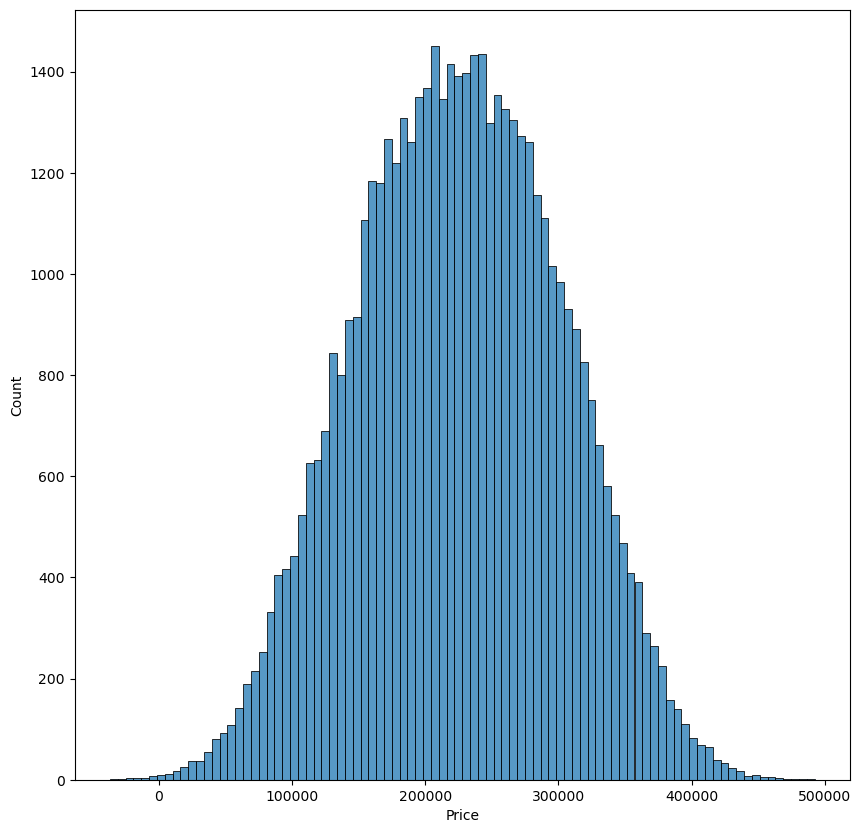

In [114]:
plt.figure(figsize=(10,10))
sns.histplot(Data["Price"])

normat


In [115]:
px.histogram(Data["Price"])

In [116]:
px.box(Data["Price"])

<Axes: xlabel='count', ylabel='Neighborhood'>

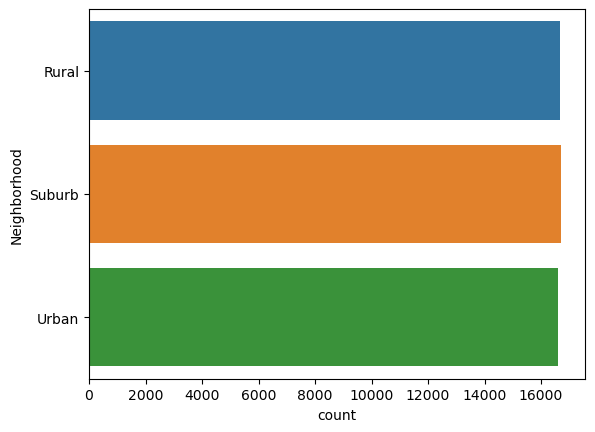

In [117]:
plt.figure()
sns.countplot(y=Data["Neighborhood"])

In [118]:
def handlar_outlayer(colum,value):
    Q1 = np.percentile(colum, 25)
    Q3 = np.percentile(colum, 75)
    IQR=Q3-Q1
    if(Q1-1.5*IQR)>value:
        return (Q1-1.5*IQR)
    elif (1.5*IQR+Q3)<value:

        return (1.5*IQR+Q3)
    else :
        return value


In [119]:
px.box(Data["Price"])

In [120]:
px.histogram(Data["Price"])

In [121]:
quantiles = Data['Price'].apply(lambda x: handlar_outlayer(Data['Price'],x))
quantiles
px.box(quantiles)

In [122]:
px.box(Data["Price"])

In [123]:
Data['Price']=quantiles

In [124]:
px.box(Data["Price"])

<Axes: xlabel='Bedrooms', ylabel='Price'>

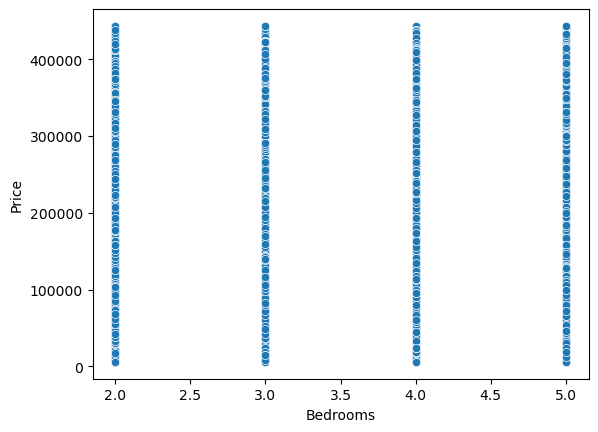

In [125]:
plt.figure()
sns.scatterplot(x=Data["Bedrooms"],y=Data["Price"])

<Axes: xlabel='SquareFeet', ylabel='Price'>

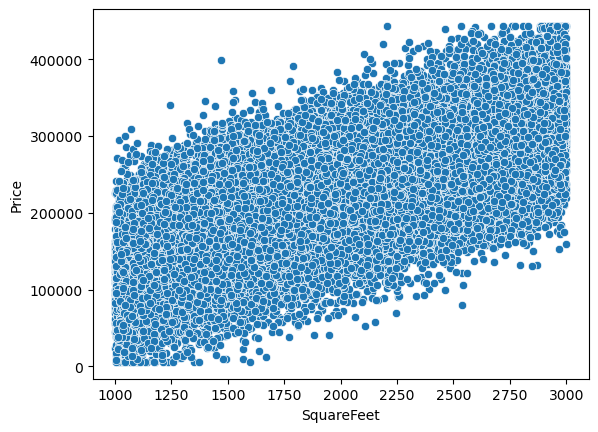

In [126]:
plt.figure()
sns.scatterplot(x=Data["SquareFeet"],y=Data["Price"])

In [127]:
Data["age"]=2025-Data["YearBuilt"]

<Axes: xlabel='age', ylabel='Price'>

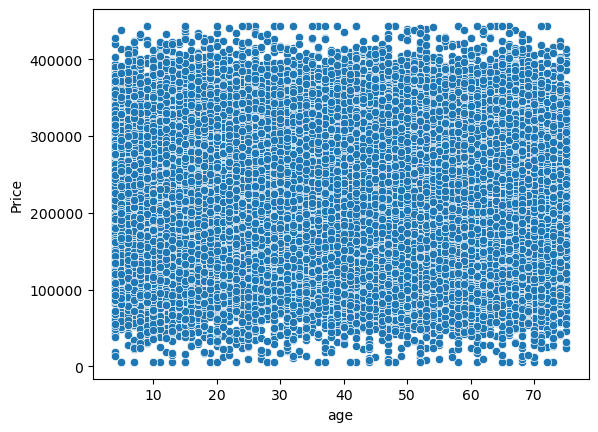

In [128]:
plt.figure()
sns.scatterplot(x=Data["age"],y=Data["Price"])

<Axes: >

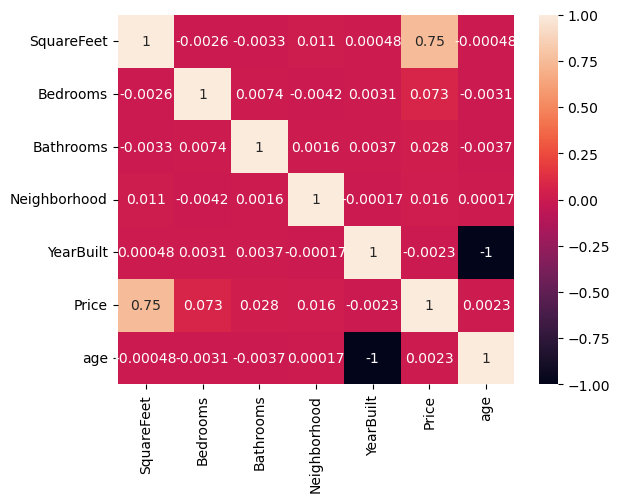

In [133]:
plt.figure()
sns.heatmap(Data.corr(),annot=True)

In [132]:
label_encoder = LabelEncoder()
Data['Neighborhood']=label_encoder.fit_transform(Data['Neighborhood'])

In [134]:
x=Data["SquareFeet"]
y=Data["Price"]
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.2)

In [135]:
LR=LinearRegression()
LR.fit(x_train.array.reshape(-1, 1),y_train)

LinearRegression()

In [136]:
LR.coef_

array([99.10377132])

In [137]:
LR.intercept_

25901.73971387191

In [138]:
y_pred=LR.predict(x_test.array.reshape(-1, 1))

In [139]:
df=pd.DataFrame({"actual":y_test,"predect":y_pred})

In [140]:
mean_error=np.sum(np.square(df["actual"]-df["predect"]))/1000

In [141]:
mean_error

25474489484.89376

In [142]:
df

,actual,predect
8221,346205.768244,280994.847097
22437,180861.373085,200225.273469
34594,130399.399083,151268.010436
5453,296209.161672,240164.093312
9455,286823.613767,310329.563408
...,...,...
21114,243177.038171,236893.668858
13199,161139.666739,222721.829559
38753,356475.727251,274553.101961
10597,5829.205484,142546.878560


In [143]:
LR.score(x_test.array.reshape(-1,1),y_test)

0.5655947787940538

In [144]:
Data.columns

Index(['SquareFeet', 'Bedrooms', 'Bathrooms', 'Neighborhood', 'YearBuilt',
       'Price', 'age'],
      dtype='object')

In [145]:
M_Data=Data[['SquareFeet', 'Bedrooms', 'Bathrooms', 'Neighborhood','age']]

In [146]:
M_Data

,SquareFeet,Bedrooms,Bathrooms,Neighborhood,age
0,2126,4,1,0,56
1,2459,3,2,0,45
2,1860,2,1,1,55
3,2294,2,1,2,29
4,2130,5,2,1,24
...,...,...,...,...,...
49995,1282,5,3,0,50
49996,2854,2,2,1,37
49997,2979,5,3,1,63
49998,2596,5,2,0,41


In [158]:
x=M_Data
y=Data["Price"]
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.1)

In [159]:
LR=LinearRegression()
LR.fit(x_train,y_train)

LinearRegression()

In [160]:
LR.coef_

array([  99.29073315, 5039.86493256, 2895.84557   ,  595.40722806,
         13.40473645])

In [161]:
LR.intercept_

961.9930492995481

In [162]:
y_pred=LR.predict(x_test)

In [163]:
df=pd.DataFrame({"actual":y_test,"predect":y_pred})

In [193]:
df['acc1']=df['actual']/df['predect']
df['acc2']=df['predect']/df['actual']
df['acc1']=df['acc1'].apply(lambda x: 0 if x>1 else x)
df['acc2']=df['acc2'].apply(lambda x: 0 if x>1 else x)
df.head(30)
ac=((100*df["acc1"]).sum()+(100*df["acc2"]).sum())/5000
print(f"acc = {ac}")
df['rang+']=df['actual']+df['actual']*.1
df['rang-']=df['actual']-df['actual']*.1

acc = 83.00834415574212


In [165]:
LR.score(x_test,y_test)

0.5634426293383119

In [166]:
mean_error=np.sum(np.square(df["actual"]-df["predect"]))/1000

In [167]:
mean_error

12776968006.215925

In [168]:
25474489484.89376-12776968006.215925

12697521478.677835

In [169]:
df.corr()

,actual,predect
actual,1.000000,0.750777
predect,0.750777,1.000000


In [194]:
df.head(30)

,actual,predect,acc1,acc2,rang+,rang-
21687,268981.111121,216072.427311,0.000000,0.803300,295879.222234,242083.000009
25669,121582.510818,135434.589822,0.897721,0.000000,133740.761900,109424.259736
6652,340410.254352,297050.799215,0.000000,0.872626,374451.279788,306369.228917
9614,278947.302313,260827.350644,0.000000,0.935042,306842.032544,251052.572081
14977,316776.720095,316927.654857,0.999524,0.000000,348454.392105,285099.048086
3908,172504.530197,203789.060257,0.846486,0.000000,189754.983217,155254.077177
25076,247409.710464,243843.880509,0.000000,0.985587,272150.681510,222668.739418
31327,168191.619582,122544.799664,0.000000,0.728602,185010.781540,151372.457624
2763,161800.540626,222005.160606,0.728814,0.000000,177980.594689,145620.486564
6476,239863.422029,241509.042970,0.993186,0.000000,263849.764232,215877.079826
